In [1]:
import os
import os.path
import json
import glob
import subprocess
import pandas as pd
import random
import torch
import requests
import faiss
import numpy as np
from tqdm import tqdm
from PIL import Image
from datetime import datetime
from transformers import AutoImageProcessor, ViTModel
import matplotlib.pyplot as plt
%matplotlib inline

## Create csv files for each crawled raw json file

In [4]:
directory_path = "./discord/final_files"
json_files = []

for root, dirs, files in os.walk(directory_path):
    for file in files:
        if file.endswith(".json"):
            json_files.append(os.path.join(root, file))
print(json_files)

['./discord/final_files/TheDungeon/The Dungeon [18+] - 🔰════〔Memes〕════🔰 - 「🎁」reddit-memes [1108915046525964288].json', './discord/final_files/meme_shitposting/Blue Politics🦅🔫🗽 - ╭-.⋅💬 | Main Channels | 💬⋅.-╮ - memes-shitposting [604701560580341771].json', './discord/final_files/MemeStash/MemeStash - 🐸 memes & media - memes [473704842104143902].json', './discord/final_files/auto_memes_2/MEMES House - MAIN 🔴 - auto-memes-2🔸 [1080157898073710643].json', './discord/final_files/meme_stealing/Meme Stealing - ‾‾‾‾‾‾‾‾‾‾Channels‾‾‾‾‾‾‾‾‾‾ - 📟image_memes [923327926143959100].json']


In [5]:
# transform json -> csv
for jf in tqdm(json_files):
    file_path = jf
    with open(file_path, 'r') as f:
        discord_data = json.load(f)
    try:
        discord_data = discord_data["messages"]
    except:
        discord_data = discord_data
    
    # filter data below 1 August 2023 (consistency with reddit data)
    filtered_data = []
    for data_dict in tqdm(discord_data):
        try:
            timestamp = data_dict['ts'] 
        except:
            timestamp = data_dict['timestamp']
        x = file_path.split("/")[3]
        try:
            timestamp_date = datetime.strptime(timestamp, '%Y-%m-%dT%H:%M:%S.%f%z')
        except:
            timestamp_date = datetime.strptime(timestamp, '%Y-%m-%dT%H:%M:%S%z')
        if timestamp_date.date() >= datetime.strptime('2023-07-01', '%Y-%m-%d').date() and timestamp_date.date() <= datetime.strptime('2023-07-31', '%Y-%m-%d').date():
            filtered_data.append(data_dict)
            
    # reverse
    filtered_data = list(reversed(filtered_data))
            
    attachment_urls = []
    ts_arr = []
    for item in tqdm(filtered_data):
        for attachment in item["attachments"]:
            attachment_urls.append(attachment["url"])
            try:
                ts_arr.append(item["ts"])
            except:
                ts_arr.append(item["timestamp"])
    if len(attachment_urls) == 0:
        for item in tqdm(filtered_data):
            for embed in item["embeds"]:
                try:
                    attachment_urls.append(embed["image"]["url"])
                    try:
                        ts_arr.append(item["ts"])
                    except:
                        ts_arr.append(item["timestamp"])
                except:
                    pass
            
    new_df = pd.DataFrame(columns=["image_url", "timestamp", "channel"])
    max_limit = 1
    channel = jf.split("/")[3]
    for url, ts in zip(attachment_urls, ts_arr):
        new_df.loc[len(new_df)] = [url, ts, channel]
        if max_limit >= 15000:
            break
        max_limit += 1
    csv_file_path = jf.replace(".json", ".csv")
    new_df.to_csv(csv_file_path, index=False)

100%|██████████████████████████████████████████████████████████████████████████████████████| 30726/30726 [00:00<00:00, 39519.85it/s]

100%|████████████████████████████████████████████████████████████████████████████████████| 12354/12354 [00:00<00:00, 1666123.20it/s]

 83%|█████████████████████████████████████████████████████████████████████▉              | 504116/605838 [00:11<00:02, 37911.48it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 605838/605838 [00:13<00:00, 45158.74it/s]

100%|████████████████████████████████████████████████████████████████████████████████████| 187164/187164 [00:03<00:00, 47043.50it/s]

100%|██████████████████████████████████████████████████████████████████████████████████████| 15757/15757 [00:00<00:00, 44258.37it/s]

100%|███████████████████████████████████████████████████████████████████████████████████████| 1779/1779 [00:00<00:00, 703399.96it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████| 4761/4761 [00:00<00:00, 43204.88it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [01:07<00:00, 13.46s/it]


## Inference on Discord Data

In [6]:
directory_path = "./discord/final_files"
csv_files = []

for root, dirs, files in os.walk(directory_path):
    for file in files:
        if file.endswith(".csv"):
            csv_files.append(os.path.join(root, file))
print(csv_files)

['./discord/final_files/TheDungeon/The Dungeon [18+] - 🔰════〔Memes〕════🔰 - 「🎁」reddit-memes [1108915046525964288].csv', './discord/final_files/meme_shitposting/Blue Politics🦅🔫🗽 - ╭-.⋅💬 | Main Channels | 💬⋅.-╮ - memes-shitposting [604701560580341771].csv', './discord/final_files/MemeStash/MemeStash - 🐸 memes & media - memes [473704842104143902].csv', './discord/final_files/auto_memes_2/MEMES House - MAIN 🔴 - auto-memes-2🔸 [1080157898073710643].csv', './discord/final_files/meme_stealing/Meme Stealing - ‾‾‾‾‾‾‾‾‾‾Channels‾‾‾‾‾‾‾‾‾‾ - 📟image_memes [923327926143959100].csv']


In [7]:
test_df = pd.DataFrame(columns=["image_url", "timestamp", "channel"])

for csv in tqdm(csv_files):
    load_df = pd.read_csv(csv)
    test_df = pd.concat([test_df, load_df])

100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:00<00:00, 45.39it/s]


In [8]:
test_df.shape

(15985, 3)

In [9]:
test_df['channel'].value_counts()

channel
TheDungeon          12044
auto_memes_2         1679
MemeStash            1131
meme_shitposting      926
meme_stealing         205
Name: count, dtype: int64

In [10]:
index = faiss.read_index('graph/out/imkg_index.index')
index_dict = np.load('graph/out/imkg_img_index_dict.npy', allow_pickle=True).item()
category_index_dict = np.load('graph/out/imkg_img_category_index_dict.npy', allow_pickle=True).item()
url_index_dict = np.load('graph/out/imkg_img_url_index_dict.npy', allow_pickle=True).item()

In [11]:
device = "cuda" if torch.cuda.is_available() else "cpu"
device

'cuda'

In [12]:
processor = AutoImageProcessor.from_pretrained("google/vit-base-patch16-224-in21k")
model = ViTModel.from_pretrained("google/vit-base-patch16-224-in21k").to(device)

In [13]:
test_images = list(test_df["image_url"])
test_ts = list(test_df["timestamp"])
test_channel = list(test_df["channel"])
k = 1
sample_test = []
for i in tqdm(range(len(test_images))):
    try:
        image = Image.open(requests.get(test_images[i], stream=True).raw)
        inputs = processor(images=image, return_tensors="pt")
        inputs = {name: tensor.to(device) for name, tensor in inputs.items()} 
        with torch.no_grad():
            outputs = model(**inputs)
            ftr = outputs.last_hidden_state
        ftr = ftr.reshape(1, -1)
        ftr_np = ftr.detach().cpu().numpy()
        faiss.normalize_L2(ftr_np)
        D, I = index.search(np.expand_dims(ftr_np[0], axis=0), k)
        sample_test.append((test_images[i], url_index_dict[I[0][0]], D, test_ts[i], test_channel[i]))
    except:
        pass

  9%|████████▏                                                                               | 1478/15985 [09:59<1:56:30,  2.08it/s]/nas/home/syjoshi/miniconda3/envs/imkg/lib/python3.8/site-packages/PIL/Image.py:3176: DecompressionBombWarning: Image size (139523344 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(
 86%|███████████████████████████████████████████████████████████████████████████            | 13796/15985 [1:33:46<14:08,  2.58it/s]

In [14]:
len(sample_test)

In [15]:
val1 = [x[0] for x in sample_test]
val2 = [x[1] for x in sample_test]
val3 = [x[2] for x in sample_test]
val4 = [x[3] for x in sample_test]
val5 = [x[4] for x in sample_test]

In [16]:
discord_inference_df = pd.DataFrame(columns=["discord image", "imkg image", "score", "timestamp", "channel"])

In [17]:
for x, y, z, t, r in tqdm(zip(val1, val2, val3, val4, val5)):
    discord_inference_df.loc[len(discord_inference_df)] = [x, y, z[0][0], t, r]
    
discord_inference_df.to_csv('./out/discord_inference_final.csv')

In [18]:
discord_inference_df.head()

In [19]:
discord_inference_df.shape

In [20]:
discord_inference_df['channel'].value_counts()

## Filter data by score

In [2]:
discord_inference_df = pd.read_csv('./out/discord_inference_final.csv', index_col=0)

In [4]:
discord_inference_df['channel'].value_counts()

channel
TheDungeon          6624
auto_memes_2        1341
MemeStash           1072
meme_shitposting     611
meme_stealing        177
Name: count, dtype: int64

In [3]:
def filter_data(df, filter_score):
    filtered_df = df[df['score']>=filter_score]
    filtered_df.reset_index(drop=True, inplace=True)
    return filtered_df

In [4]:
filter_score = 0.50
filtered_df_50 = filter_data(discord_inference_df, filter_score)
filtered_df_50.to_csv('./out/discord_filtered_df_50_final.csv')
filtered_df_50.shape

(2515, 5)

In [5]:
filter_score = 0.60
filtered_df_60 = filter_data(discord_inference_df, filter_score)
filtered_df_60.to_csv('./out/discord_filtered_df_60_final.csv')
filtered_df_60.shape

(1624, 5)

In [6]:
filter_score = 0.70
filtered_df_70 = filter_data(discord_inference_df, filter_score)
filtered_df_70.to_csv('./out/discord_filtered_df_70_final.csv')
filtered_df_70.shape

(944, 5)

In [7]:
filter_score = 0.90
filtered_df_90 = filter_data(discord_inference_df, filter_score)
filtered_df_90.to_csv('./out/discord_filtered_df_90_final.csv')
filtered_df_90.shape

(108, 5)

## Plot filtered data - potential match

In [8]:
def plot_match_data(max_len, images1, images2):
    nrows, ncols = min(10, max_len), 2
    fig, axes = plt.subplots(nrows, ncols, figsize=(20, 50))
    image1, image2 = "", "" 
    for i in range(min(10, max_len)):
        image1 = Image.open(requests.get(images1[i], stream=True).raw)
        axes[i, 0].imshow(image1)
        axes[i, 0].axis('off')
        image2 = Image.open(requests.get(images2[i], stream=True).raw)
        axes[i, 1].imshow(image2)
        axes[i, 1].axis('off')

    plt.tight_layout()
    plt.show()

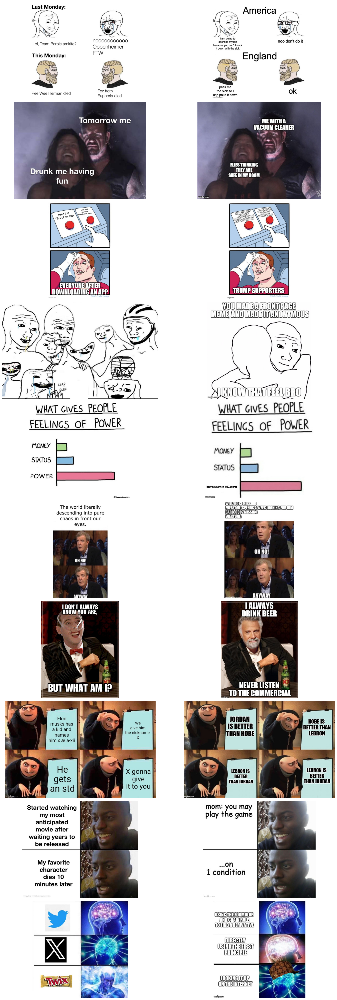

In [9]:
filtered_df = pd.read_csv('./out/discord_filtered_df_50_final.csv')
images1 = list(filtered_df['discord image'].values)
images2 = list(filtered_df['imkg image'].values)
plot_match_data(len(filtered_df), images1, images2)

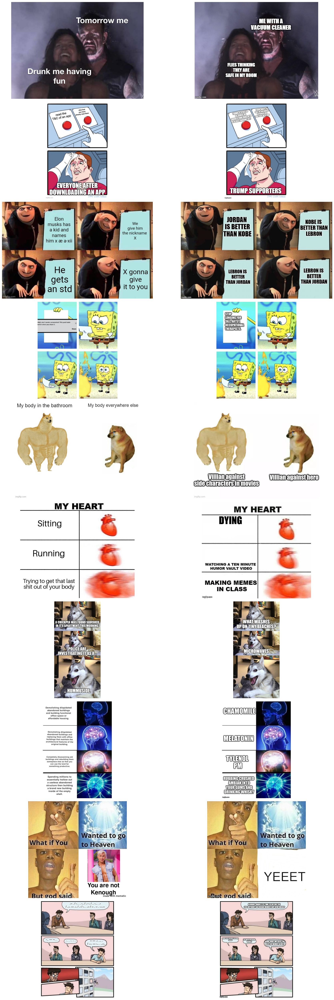

In [10]:
filtered_df = pd.read_csv('./out/discord_filtered_df_70_final.csv')
images1 = list(filtered_df['discord image'].values)
images2 = list(filtered_df['imkg image'].values)
plot_match_data(len(filtered_df), images1, images2)

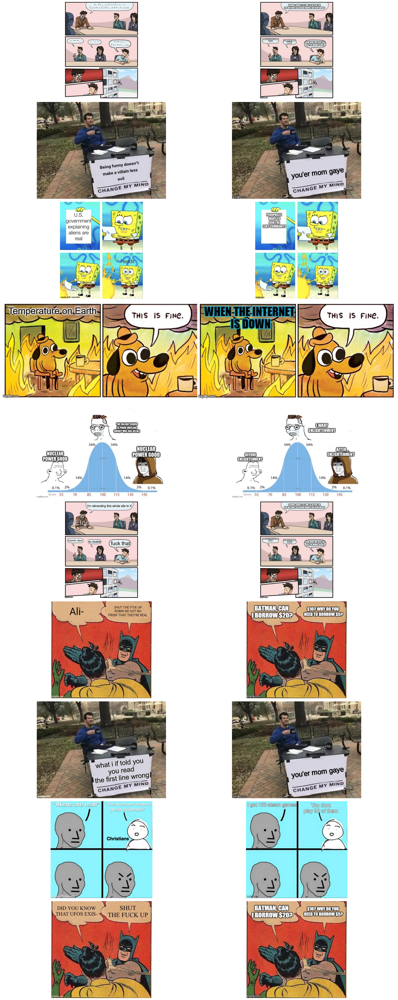

In [11]:
filtered_df = pd.read_csv('./out/discord_filtered_df_90_final.csv')
images1 = list(filtered_df['discord image'].values)
images2 = list(filtered_df['imkg image'].values)
plot_match_data(len(filtered_df), images1, images2)